In [9]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import math
import os
import pickle

%matplotlib inline

给定一组棋盘图像，计算相机校准矩阵和失真系数。
对原始图像应用失真校正。
使用颜色变换，渐变等，创建阈值二进制图像。
应用透视变换来纠正二进制图像（“鸟瞰视图”）。
检测车道像素并适合查找车道边界。
确定车道的曲率和相对于中心的车辆位置。
将检测到的车道边界扭曲回原始图像。
输出车道边界的视觉显示和车道曲率和车辆位置的数值估计。

相机校准的图像存储在名为camera_cal的文件夹中。 test_images中的图像用于在单个帧上测试管道。 为了帮助审阅者检查您的工作，请将您流水线每个阶段的输出示例保存在名为ouput_images的文件夹中，并在每个图像显示的项目的README中包含一个说明。 名为project_video.mp4的视频是您的管道应该工作的视频。


首先，给定一组棋盘图像（在存储库中的camera_cal文件夹中），计算相机校准矩阵和失真系数。

接下来，对于一系列测试映像（在存储库中的test_images文件夹中）：
对原始图像应用失真校正。
使用颜色变换，渐变等，创建阈值二进制图像。
应用透视变换来纠正二进制图像（“鸟瞰视图”）。
检测车道像素并适合查找车道边界。
确定车道的曲率和相对于中心的车辆位置。
将检测到的车道边界扭曲回原始图像。
输出车道边界的视觉显示和车道曲率和车辆位置的数值估计。


参考：
https://github.com/ninopereira/advanced_lane_lines

https://github.com/WuStangDan/Project-04-Advanced-Lane-Lines

This image is: <class 'numpy.ndarray'> with dimesions: (720, 1280, 3)


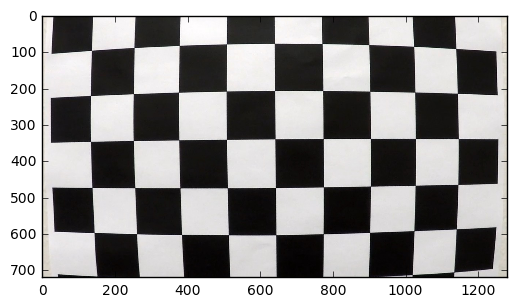

In [10]:
#reading in an image
image = mpimg.imread('calibration1.jpg')
#printing out some stats and plotting
print('This image is:', type(image), 'with dimesions:', image.shape)
plt.imshow(image)  #call as plt.imshow(gray, cmap='gray') to show a grayscaled image

In [11]:
import os
os.listdir("camera_cal/")

['calibration1.jpg',
 'calibration2.jpg',
 'calibration3.jpg',
 'calibration4.jpg',
 'calibration5.jpg']

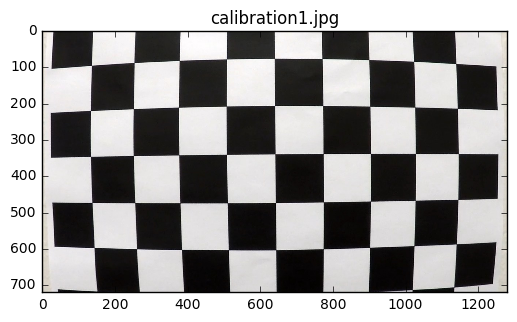

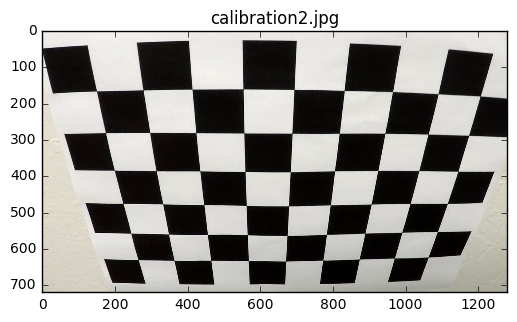

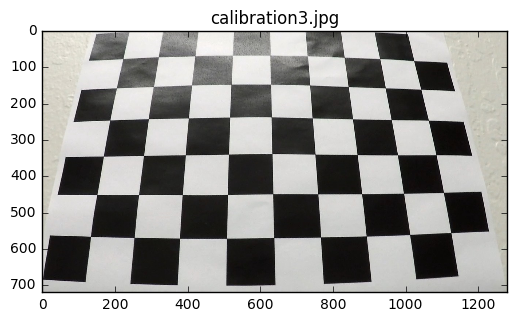

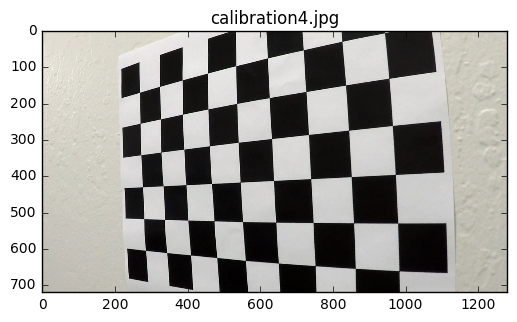

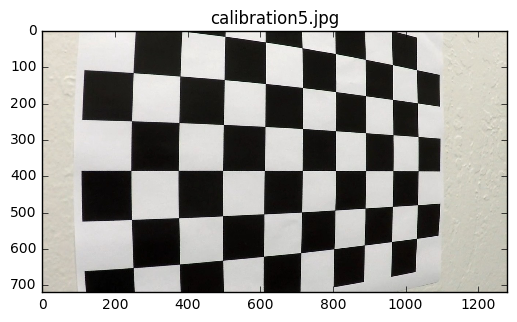

In [12]:
###输出棋盘图像
myimgs = os.listdir("camera_cal/")
for item in myimgs:
    path="camera_cal/"+item
    image = mpimg.imread(path)
    #p_img = process_image(image)
    #plt.imshow(p_img)
    plt.imshow(image, cmap='gray')
    plt.title(item)
    plt.show()

In [26]:
####失真校正


objpoints = [] # 3D points in real world space
imgpoints = [] # 2D points in image plane

objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)


def camera(img,nx,ny):
    
    
    
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    if ret == True:
       
        imgpoints.append(corners)
        objpoints.append(objp)
        # Draw and display the corners
        img=cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        plt.imshow(img)
        
    #img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
    #ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
    #return mtx,dist


In [34]:
def draw2Img(img1,img2,title1,title2):
    layout, (plt1, plt2) = plt.subplots(1, 2, figsize=(10, 5))
    layout.tight_layout()
    plt1.imshow(img1)
    plt1.set_title(title1)
    
  
    img2 = np.asarray(img2)
    plt2.imshow(img2)
    plt2.set_title(title2)
    plt.show()


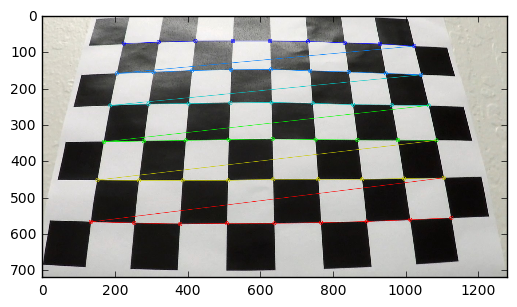

In [30]:

nx = 9 # number of inside corners in x
ny = 6 # number of inside corners in y
myimgs = os.listdir("camera_cal/")
for item in myimgs:
    path="camera_cal/"+item
    image = mpimg.imread(path)
    camera(image,nx, ny)
    #undistort_image = cv2.undistort(image, mtx, dist, None, mtx)
    
    ###save image
    #cv2.imwrite("ouput_images/"+item, undistort_image)
    ###display image
    #draw2Img(image,undistort_image,'Original '+item,'Undistorted '+item)
   
  
    


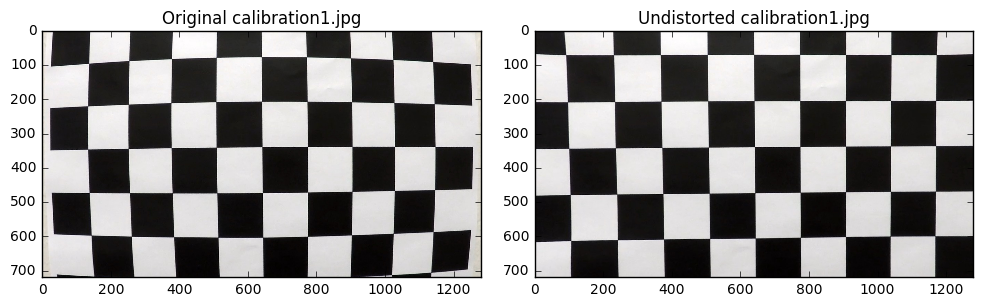

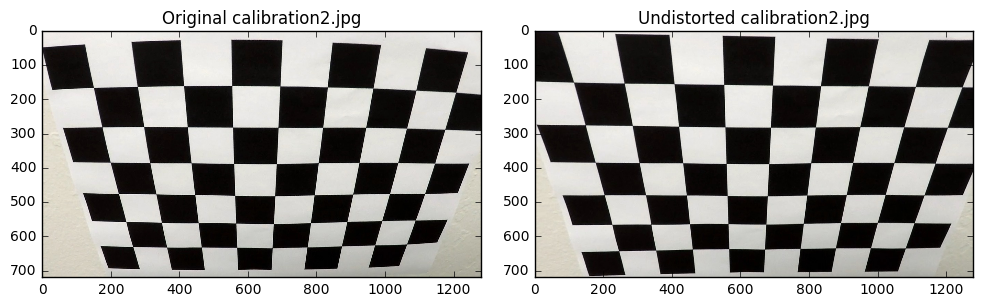

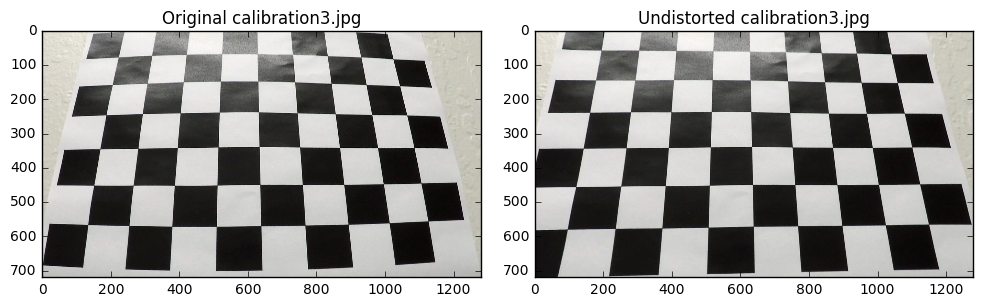

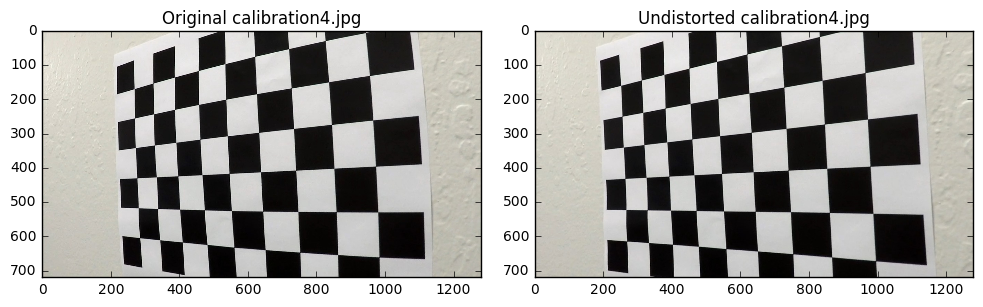

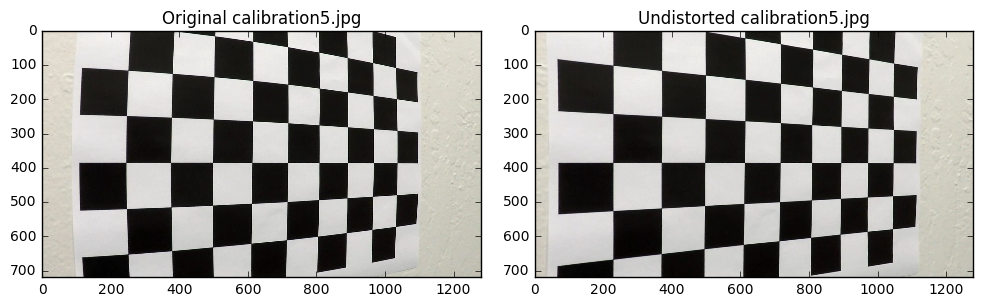

In [39]:
def img_undistort(img, objpoints, imgpoints):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) # Must read image using mpimg.imread
    
    output = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    
    undist = cv2.undistort(img, output[1], output[2], None, output[1])
    return undist, output

myimgs = os.listdir("camera_cal/")
for item in myimgs:
    path="camera_cal/"+item
    image = mpimg.imread(path)
    
    undistort, camOut =  img_undistort(image, objpoints, imgpoints)
    draw2Img(image,undistort,'Original '+item,'Undistorted '+item)

In [40]:
#####使用相机得到的校准矩阵和失真系数对原始图像应用失真校正
def test_imagewithcamera(img,objpoints,imgpoints):
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
    return mtx,dist

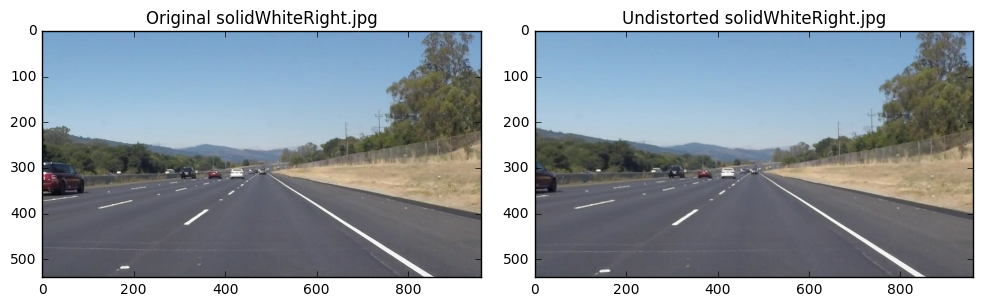

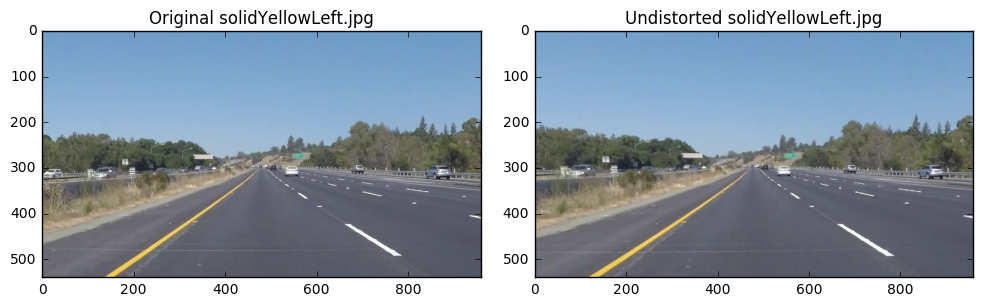

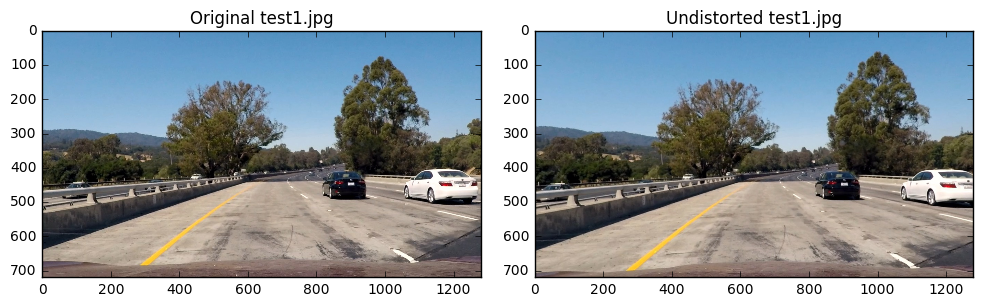

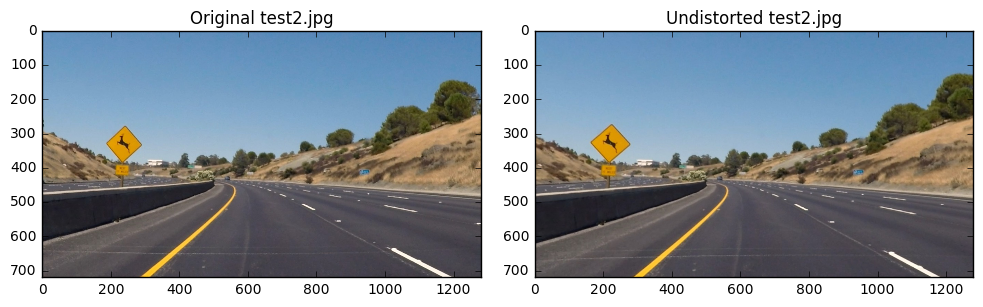

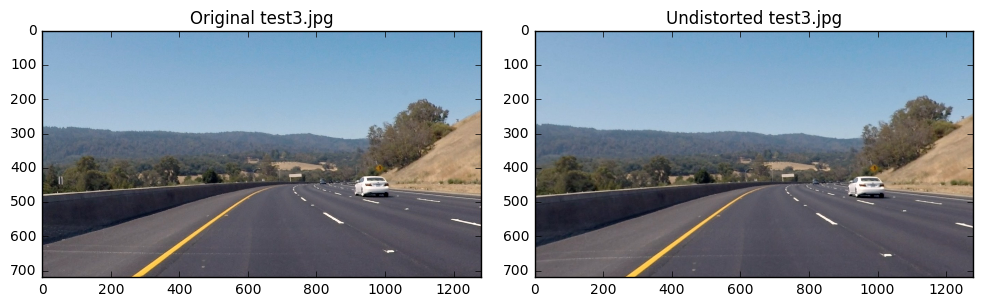

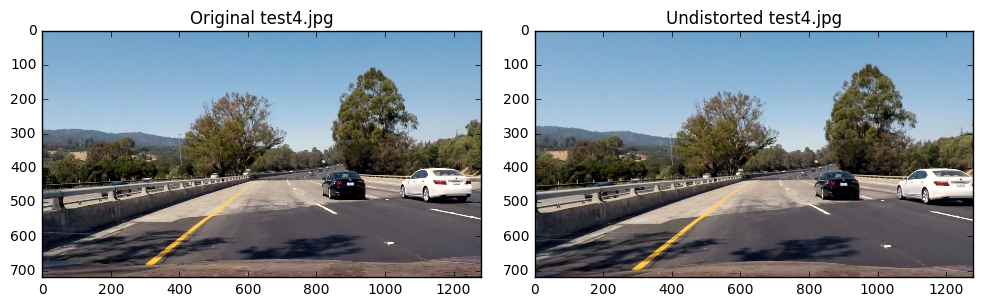

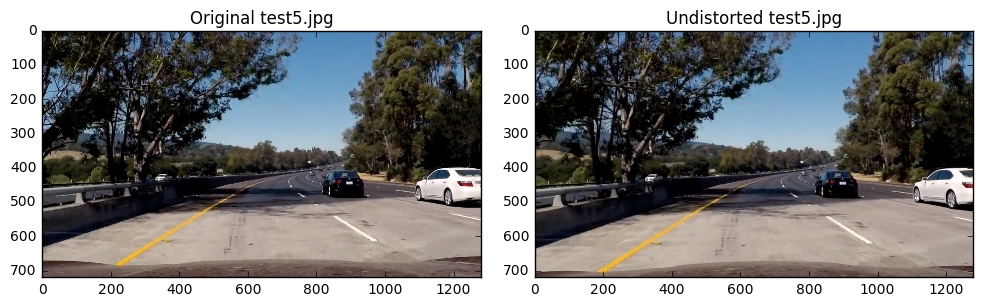

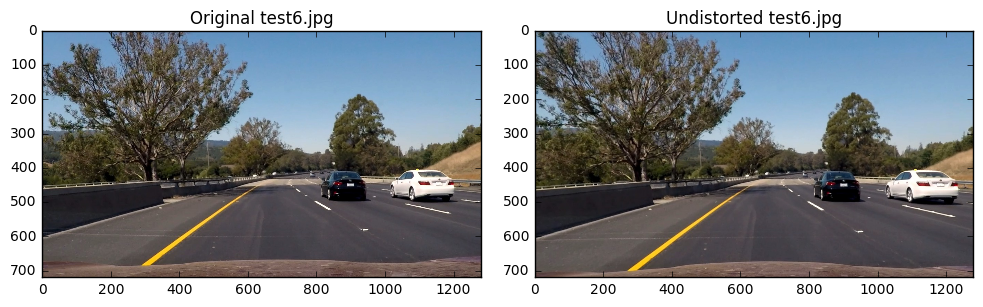

In [41]:
###对原始图像应用失真校正

myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    mtx,dist = test_imagewithcamera(image,objpoints, imgpoints)
    undistort_image = cv2.undistort(image, mtx, dist, None, mtx)
    
    ###save image
    #cv2.imwrite("ouput_images/"+item, undistort_image)
    ###display image
    draw2Img(image,undistort_image,'Original '+item,'Undistorted '+item)
    

In [42]:
###### 使用颜色变换，渐变等，创建阈值二进制图像。
# Read in an image
#image = mpimg.imread('signs_vehicles_xygrad.png')

# Define a function that applies Sobel x and y, 
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output
    




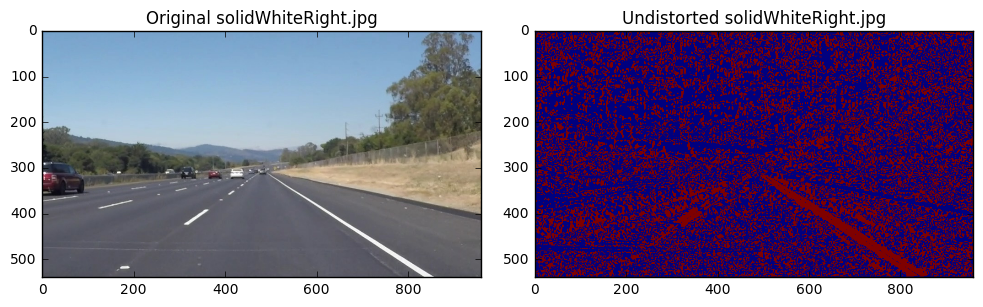

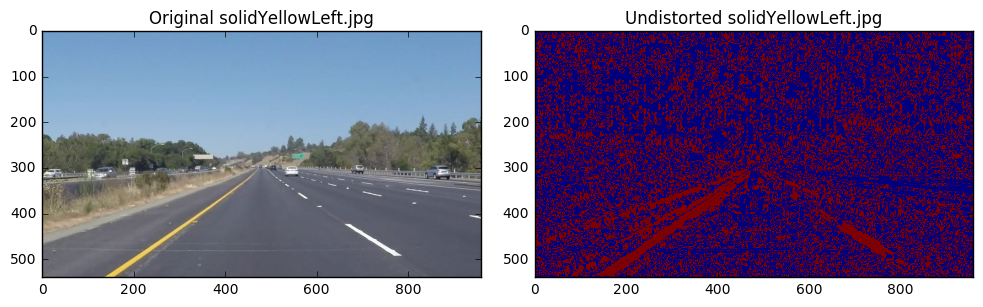

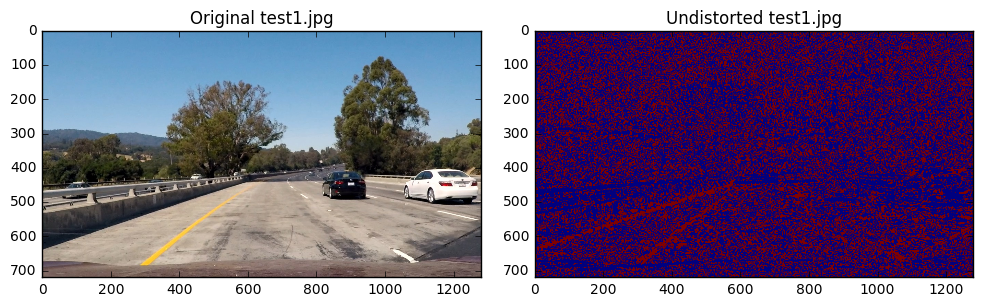

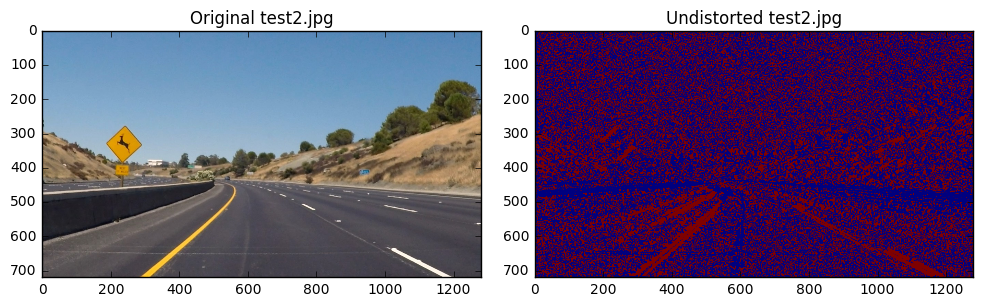

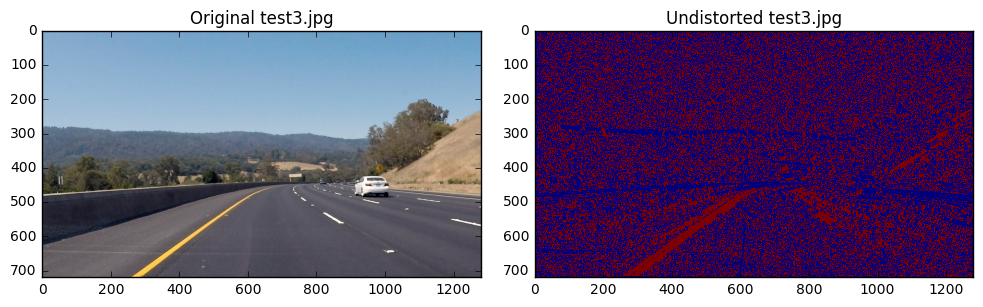

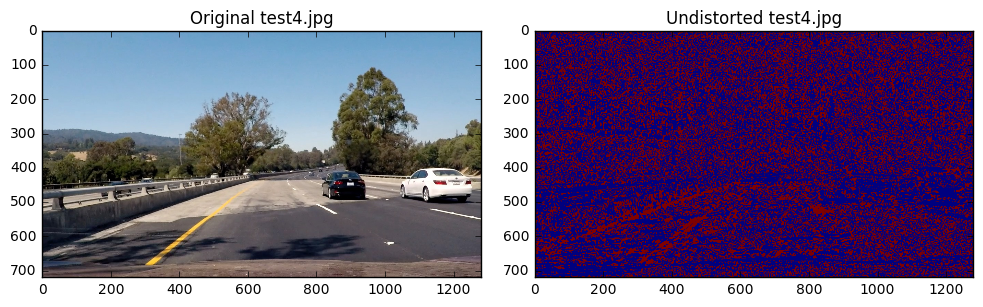

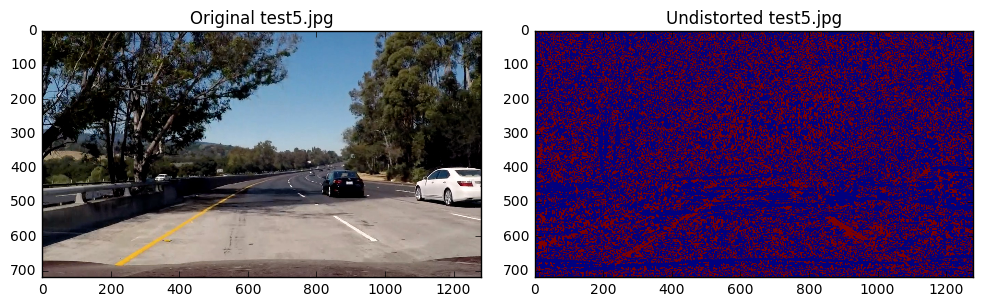

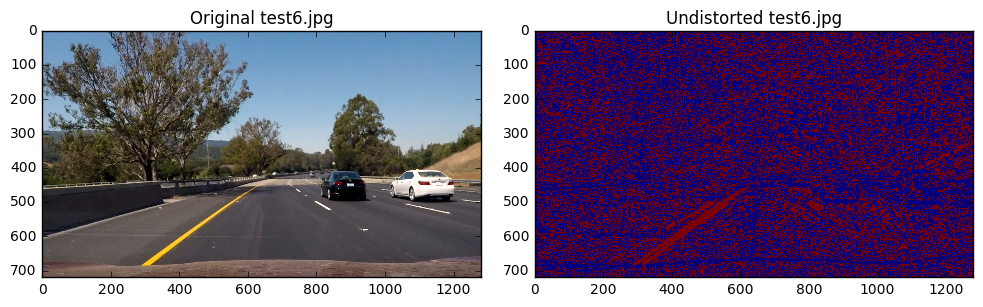

In [43]:
#test
myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    # Run the function
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    
    ###save image
    #cv2.imwrite("ouput_images/"+item, undistort_image)
    ###display image
    draw2Img(image,dir_binary,'Original '+item,'Undistorted '+item)

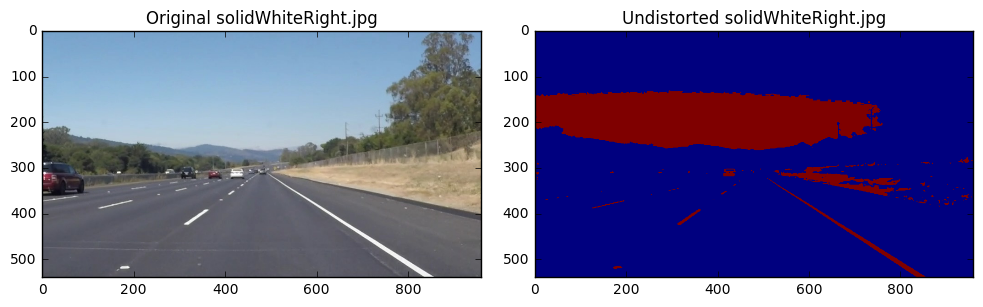

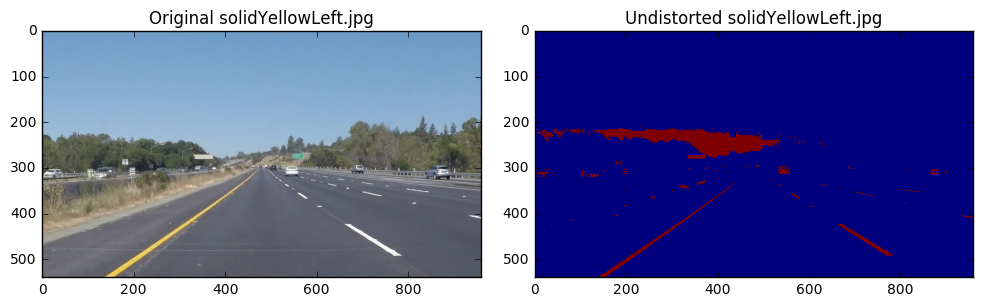

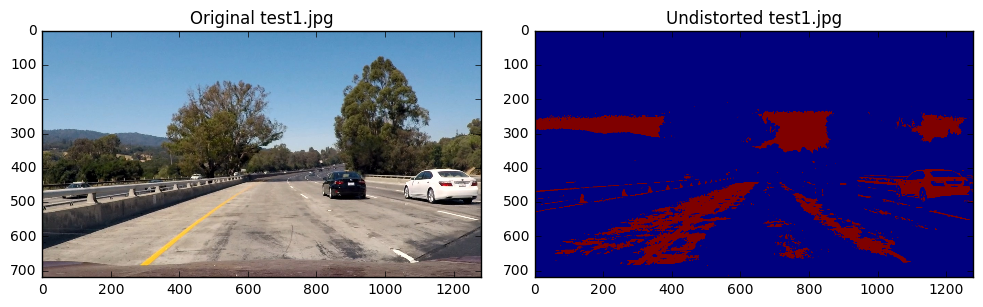

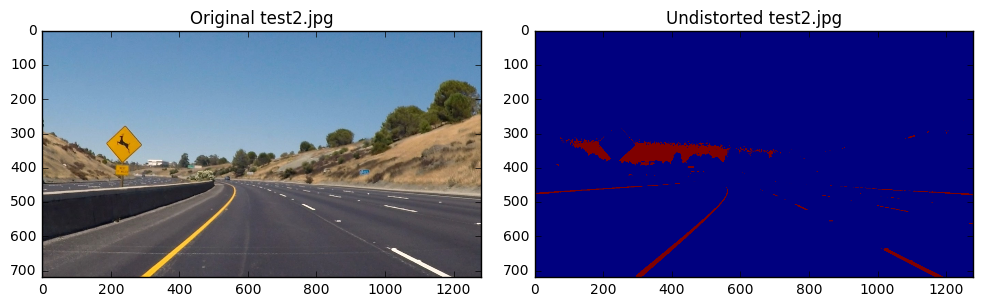

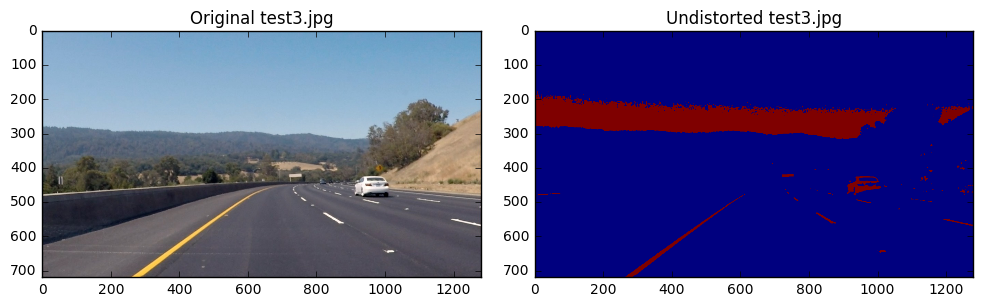

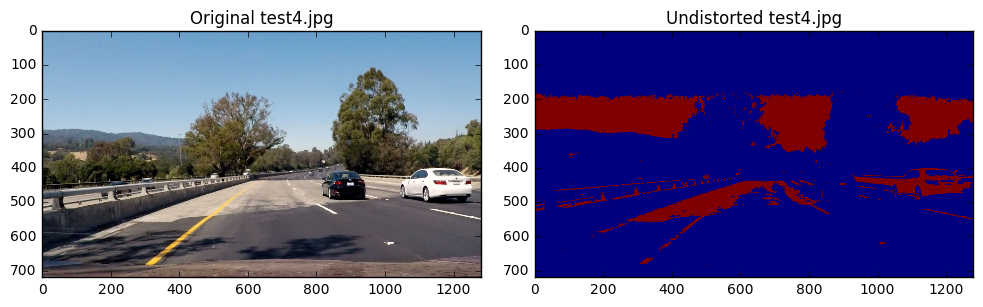

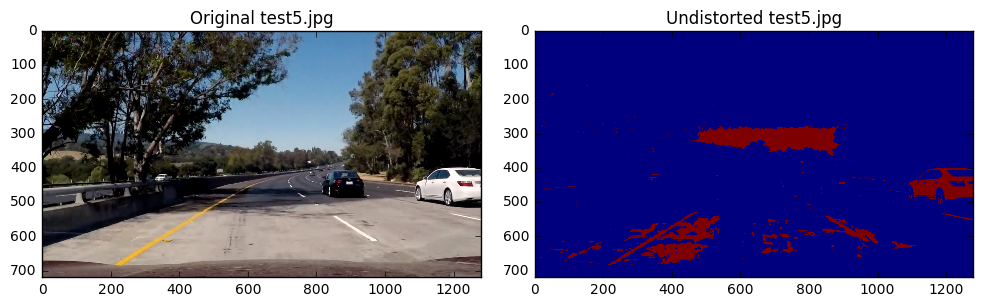

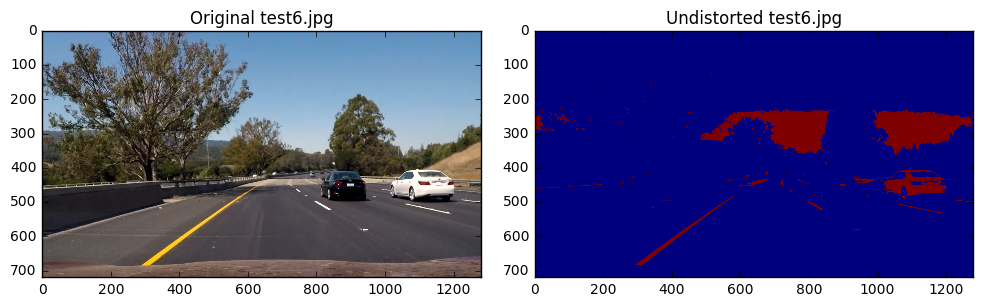

In [45]:
####应用透视变换来纠正二进制图像（“鸟瞰视图”）

####HLS和颜色阈值


#image = mpimg.imread('test6.jpg')

def hlsimg(img):
    thresh = (180, 255)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    binary = np.zeros_like(gray)
    binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    return binary

#plt.imshow(hlsimg(image))

myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    # Run the function
    dir_binary = hlsimg(image)
    
    ###save image
    #cv2.imwrite("ouput_images/"+item, undistort_image)
    ###display image
    draw2Img(image,dir_binary,'Original '+item,'Undistorted '+item)


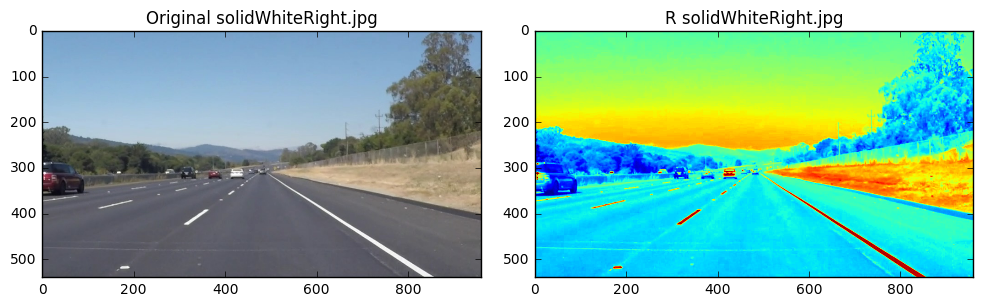

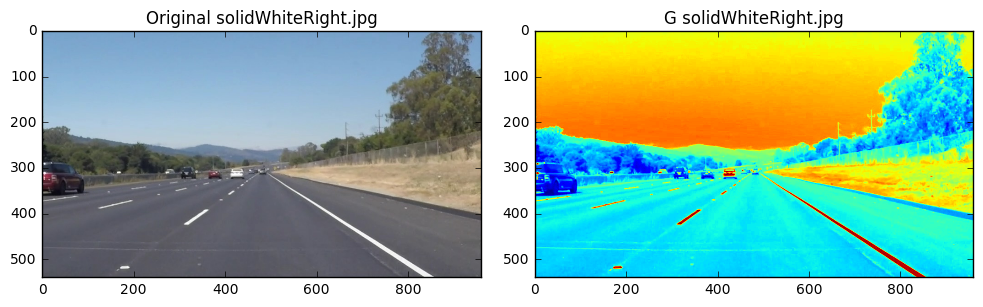

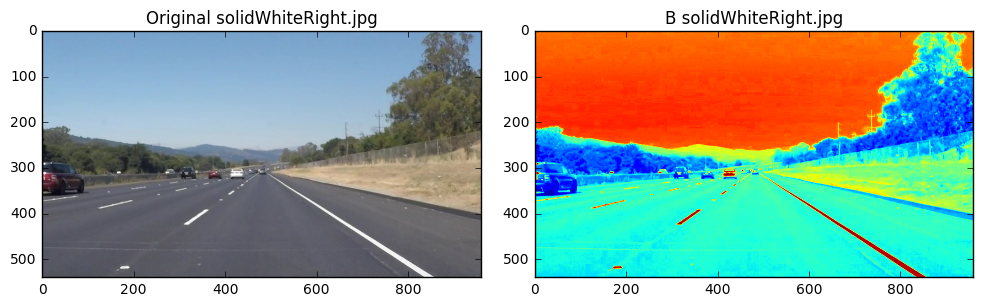

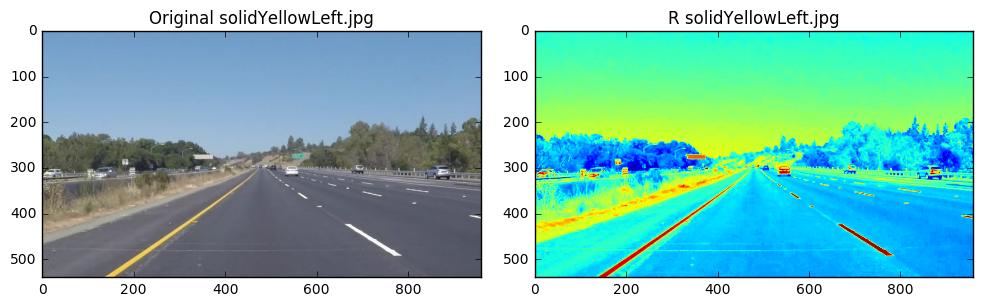

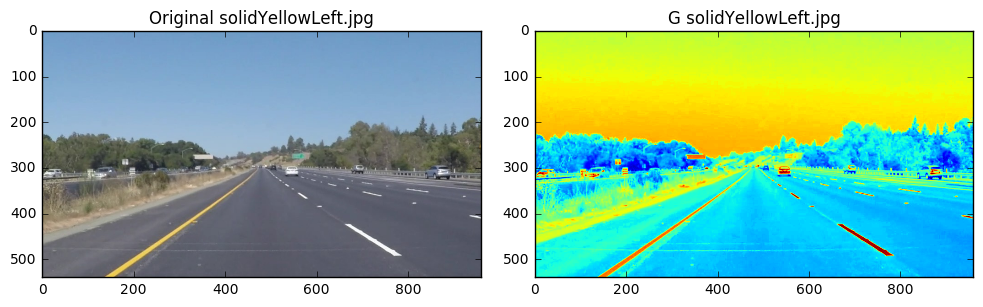

...

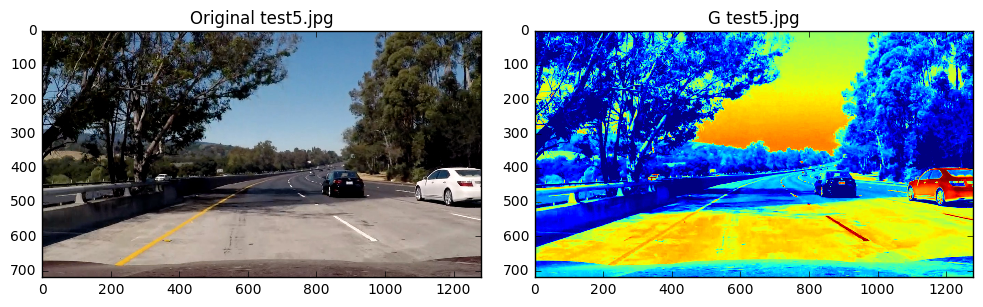

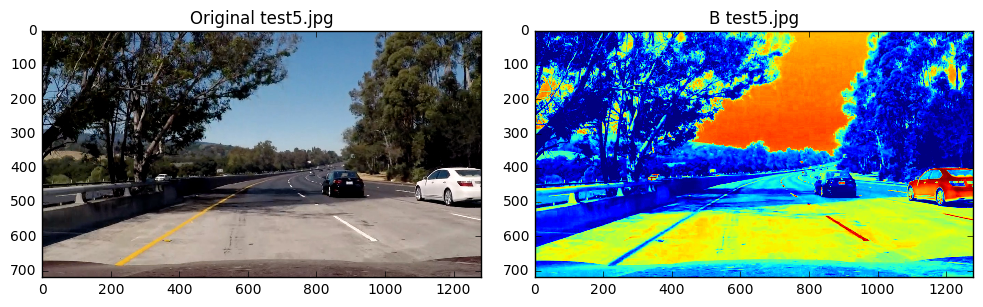

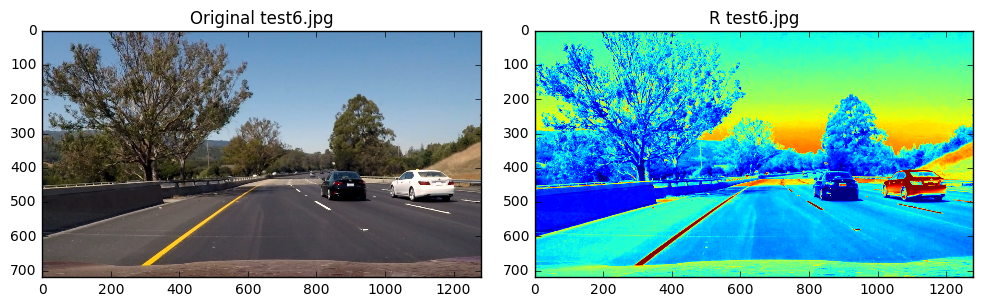

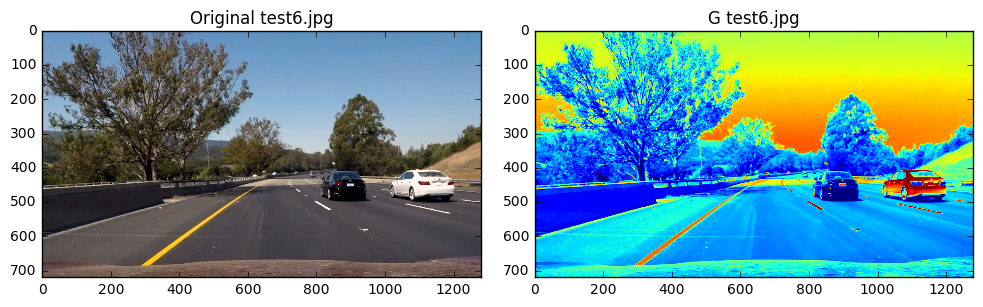

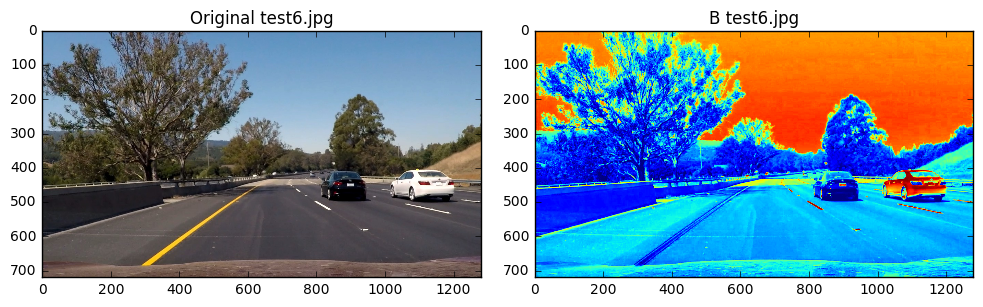

In [46]:
#探索了阈值单个RGB颜色通道

myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    # Run the function
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    
    ###save image
    #cv2.imwrite("ouput_images/"+item, undistort_image)
    ###display image
    draw2Img(image,R,'Original '+item,'R '+item)
    draw2Img(image,G,'Original '+item,'G '+item)
    draw2Img(image,B,'Original '+item,'B '+item)

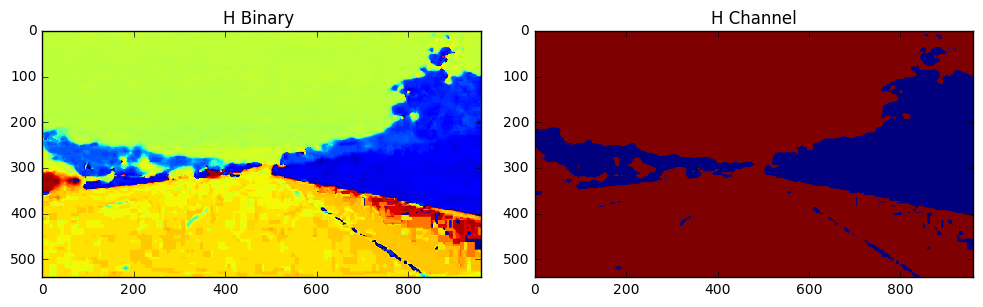

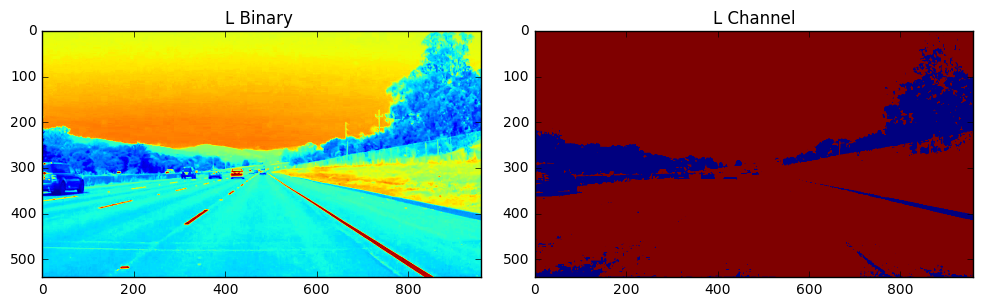

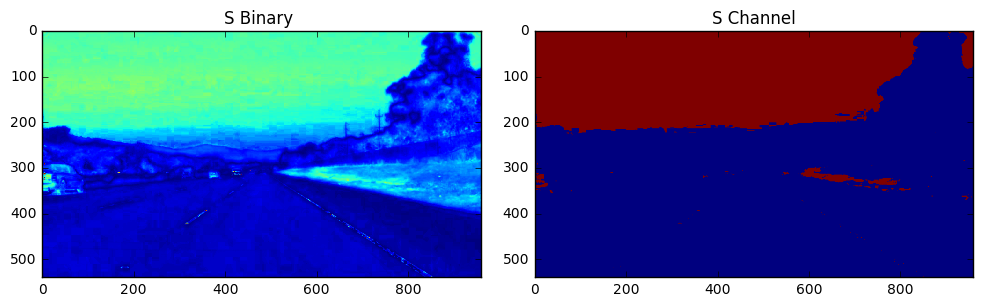

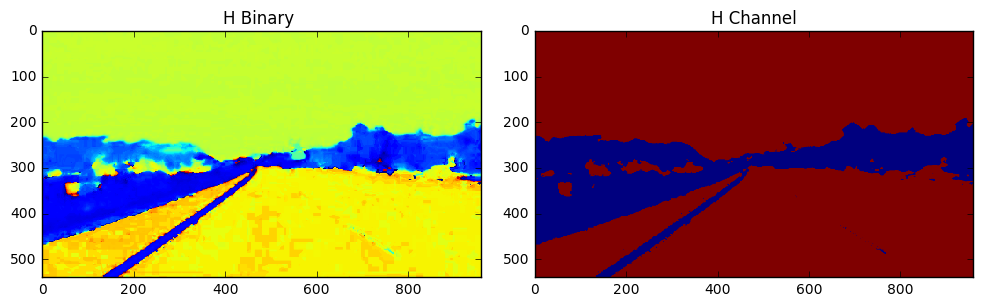

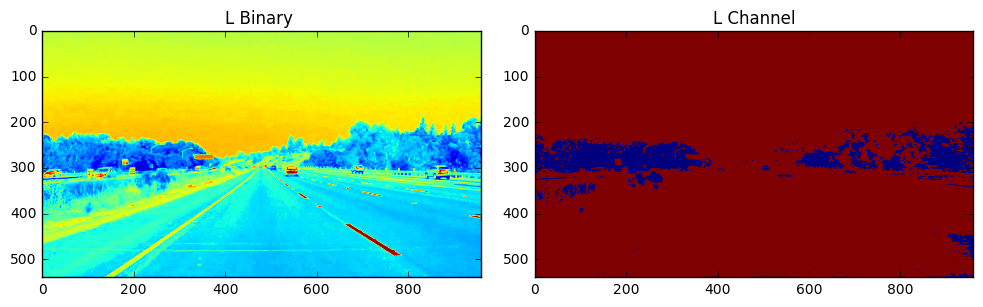

...

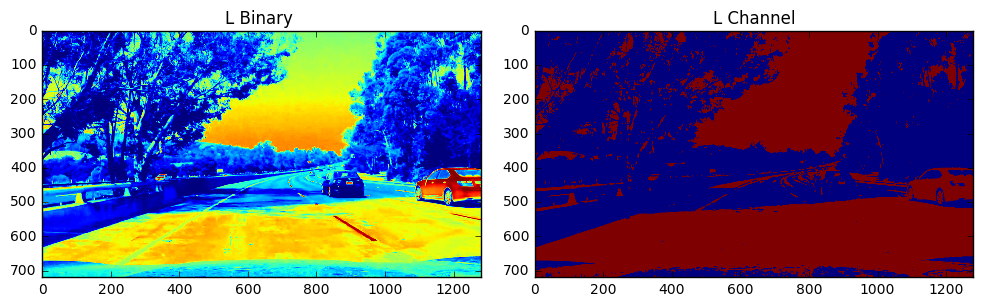

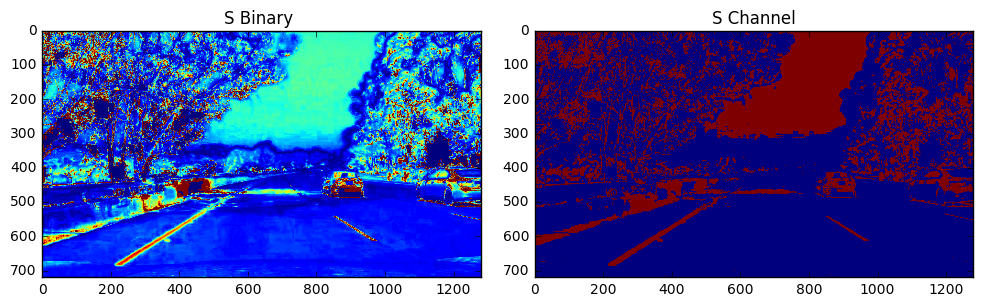

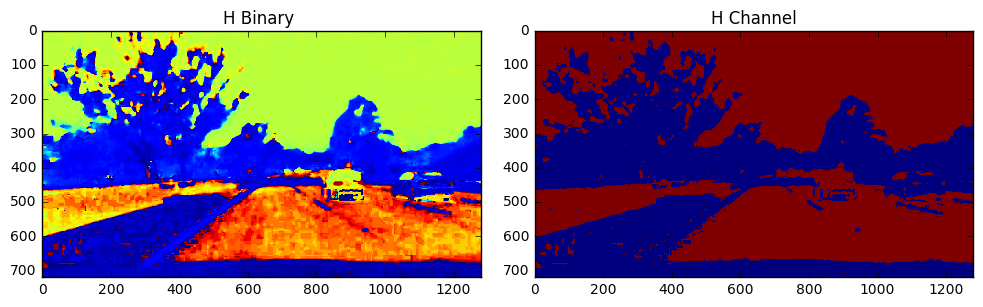

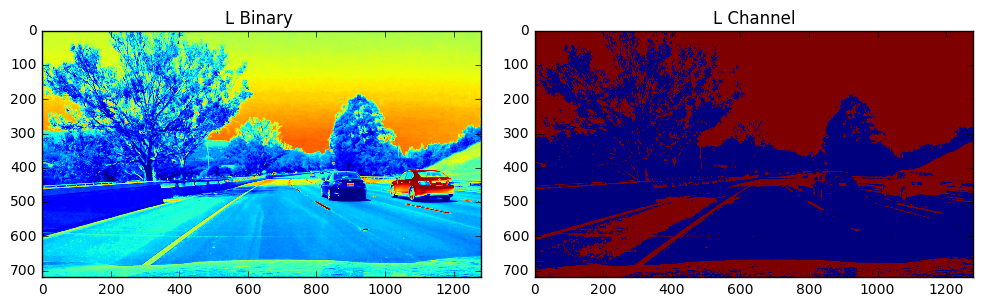

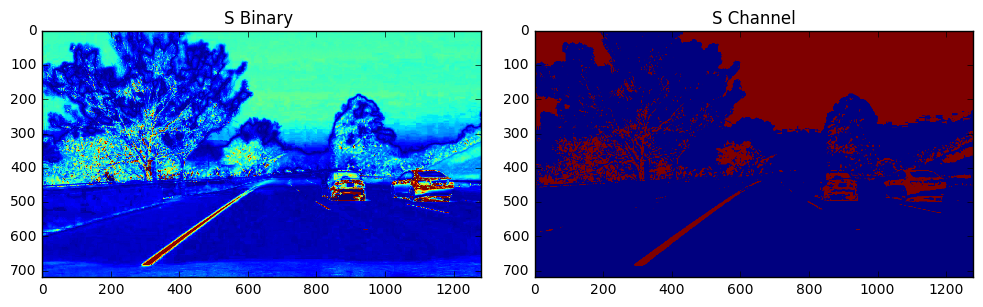

In [49]:
###这里我们将特别看看HLS。 当我们分离H，L和S通道时，我们得到以下结果


def s_select(img):
    thresh = (90, 255)
    binary = np.zeros_like(img)
    binary[(img > thresh[0]) & (img <= thresh[1])] = 1
    return binary

#S通道很好地拾取线，所以让我们尝试应用阈值：

myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    #draw2Img(H,s_select(H),'H Binary ','H Channel')
    draw2Img(L,s_select(L),'L Binary ','L Channel')
    draw2Img(S,s_select(S),'S Binary ','S Channel')

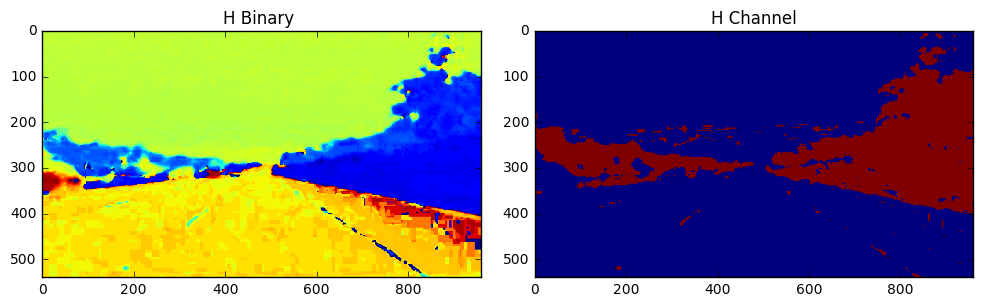

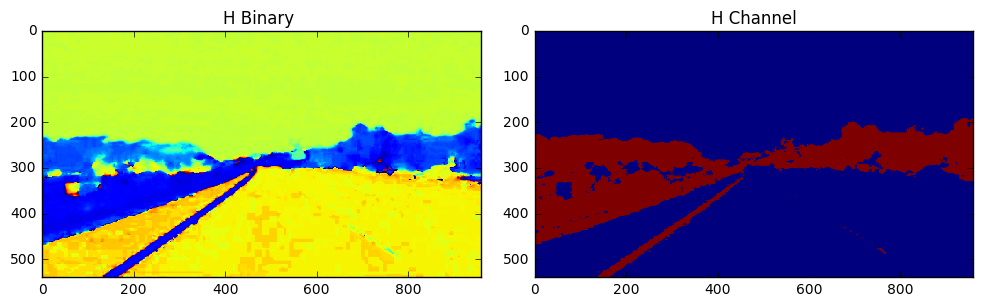

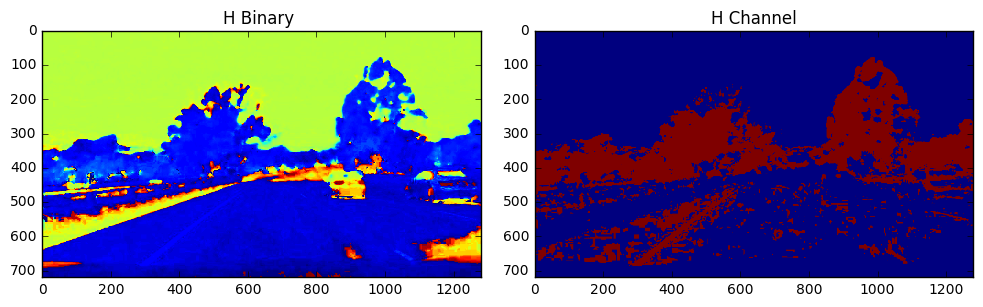

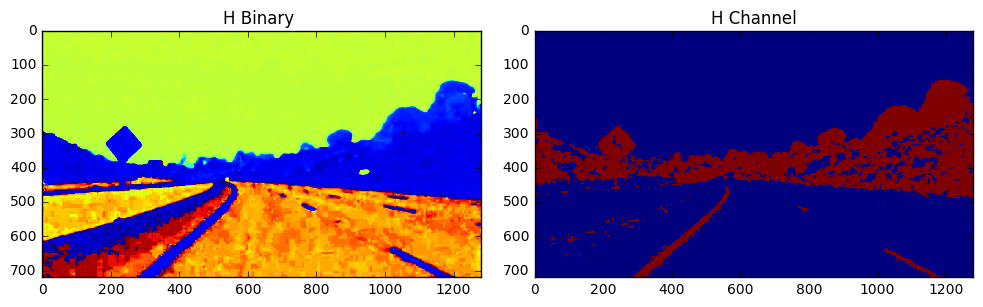

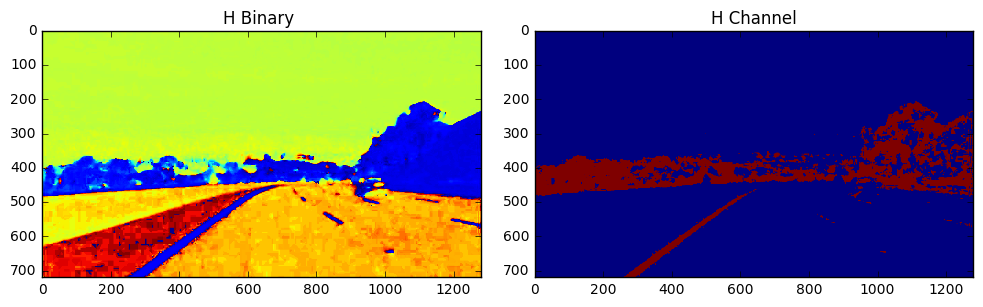

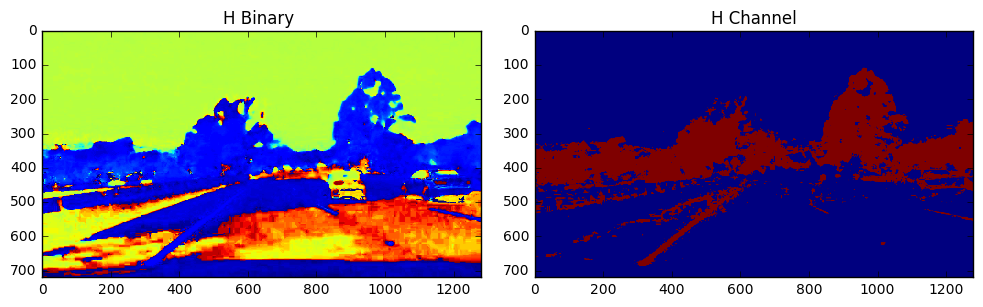

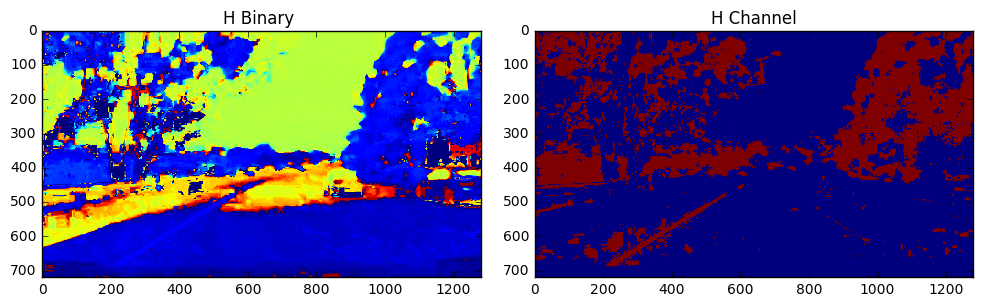

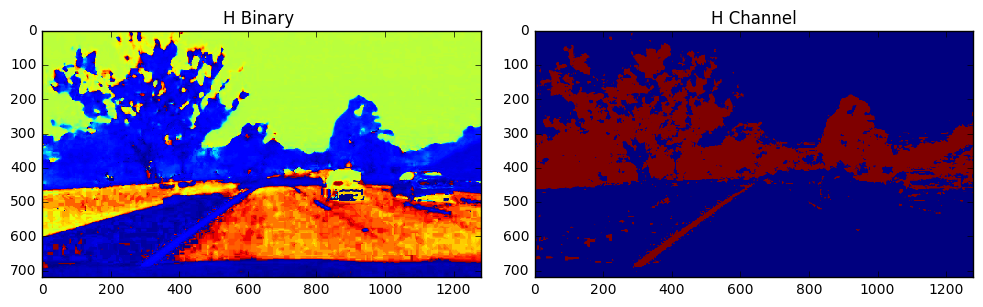

In [50]:
#您还可以看到，在H通道中，车道线显示为暗，因此我们可以尝试低阈值并获得以下结果：
def h_select(H):
    thresh = (15, 100)
    binary = np.zeros_like(H)
    binary[(H > thresh[0]) & (H <= thresh[1])] = 1
    return binary


myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    draw2Img(H,h_select(H),'H Binary ','H Channel')

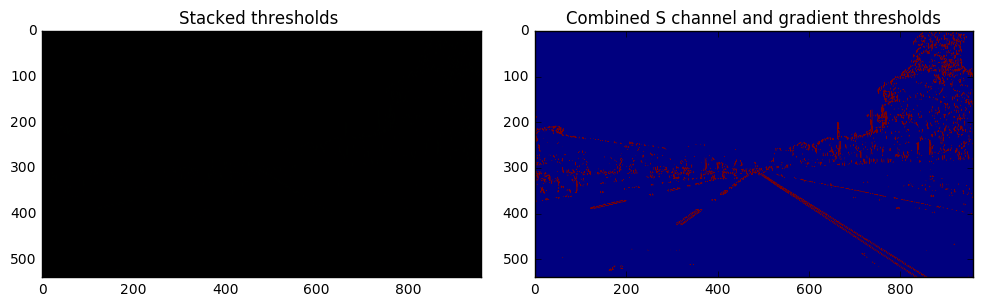

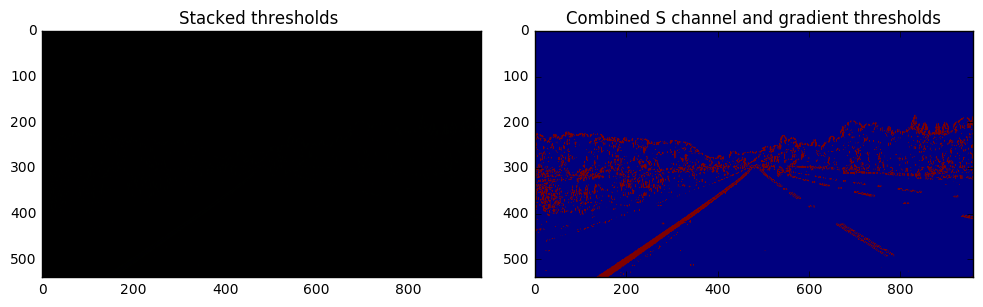

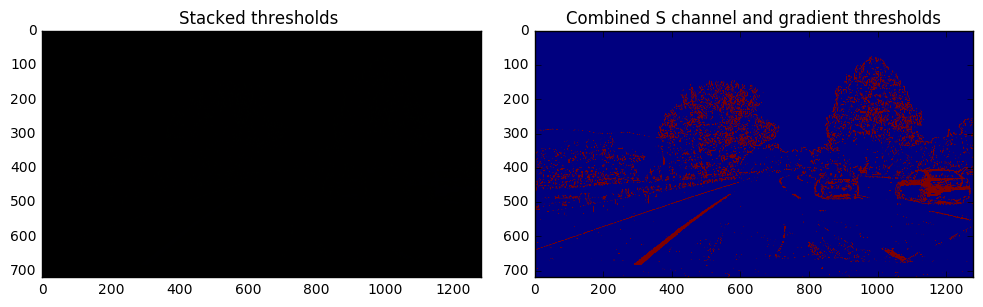

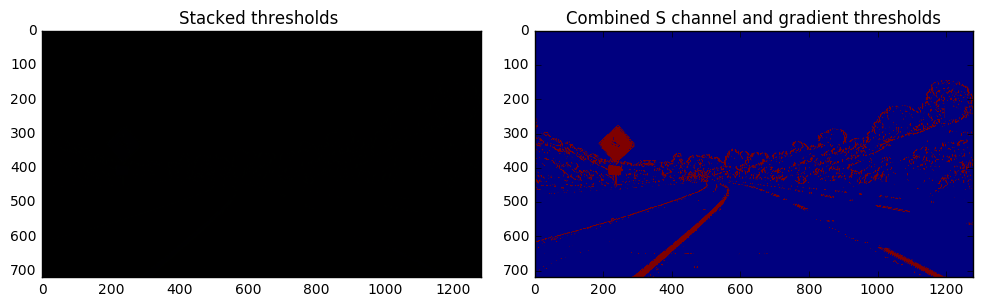

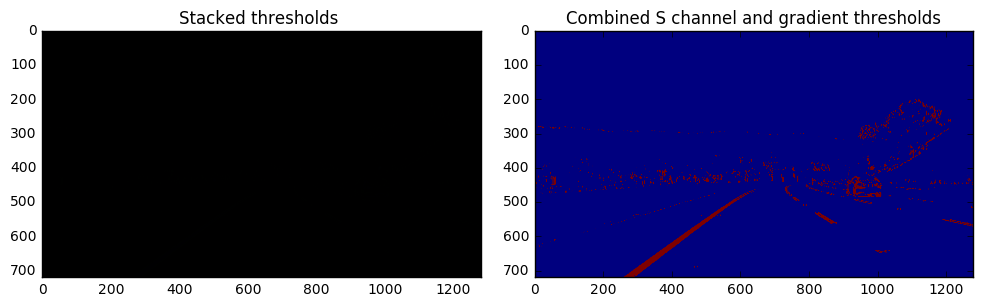

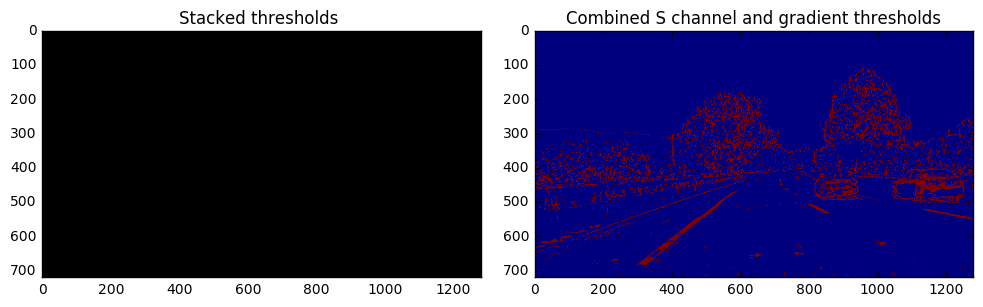

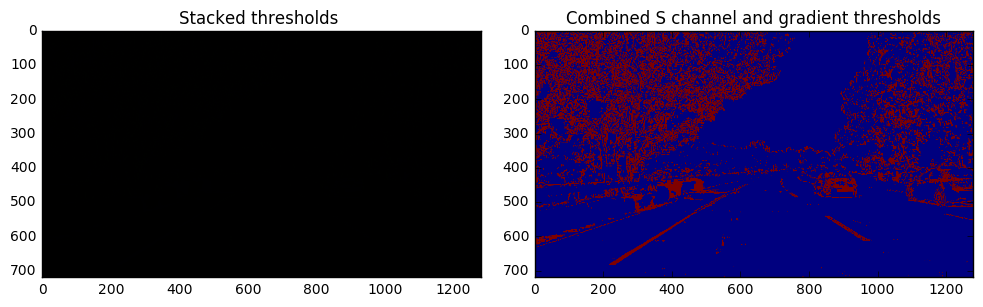

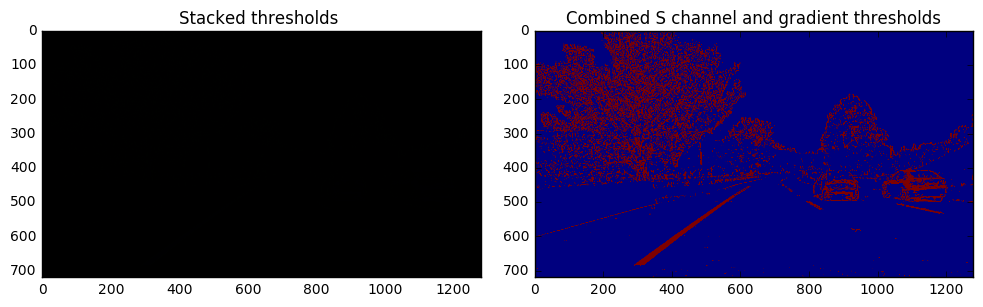

In [52]:
########颜色和渐变

def color_and_gradients(img):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]

    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Threshold color channel
    s_thresh_min = 170
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return color_binary,combined_binary





myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    
    color_binary,combined_binary=color_and_gradients(image)
    # Plotting thresholded images
    draw2Img(color_binary,combined_binary,'Stacked thresholds ','Combined S channel and gradient thresholds')


In [53]:
def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

In [56]:
# camera matrix and distortion coefficients
#def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    #undist = cv2.undistort(img, mtx, dist, None, mtx)
    
#Minv = cv2.getPerspectiveTransform(dst, src)    
# Define a function that takes an image, number of x and y points, 
# camera matrix and distortion coefficients
def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 100 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
    return warped, M,undist

In [62]:
def process_image(image):
    #imagess = os.listdir("test_images/")
   
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 3
    low_threshold = 50
    high_threshold = 150


    ## Read in and grayscale the image
    gray = grayscale(image)
    # apply Gaussian smoothing
    blur_gray =gaussian_blur(image,kernel_size)

    edges = canny(blur_gray, low_threshold, high_threshold)

    ## Next we'll create a masked edges image using cv2.fillPoly()
    imshape = image.shape
    #vertices = np.array([[(0,imshape[0]),(450, 290), (490, 290), (imshape[1],imshape[0])]], dtype=np.int32)
    vertices = np.array([[imshape[1]*0, imshape[0]],[imshape[1]*0.44, imshape[0]*0.62],
                        [imshape[1]*0.55, imshape[0]*0.62],[imshape[1], imshape[0]]],dtype=np.int32)
    masked_edges=region_of_interest(edges,vertices=[vertices])


    rho = 2 # distance resolution in pixels of the Hough grid
    theta = np.pi/180 # angular resolution in radians of the Hough grid
    threshold = 15     # minimum number of votes (intersections in Hough grid cell)
    min_line_length =150  #minimum number of pixels making up a line
    max_line_gap = 180        # maximum gap in pixels between connectable line segments
    line_image = np.copy(image)*0 # creating a blank to draw lines on

    

    #Run Hough on edge detected image
    lines = hough_lines(masked_edges, rho, theta, threshold, min_line_length, max_line_gap)


    # Create a "color" binary image to combine with line image
    color_edges = np.dstack((edges, edges, edges))

    # Draw the lines on the edge image
    lines_edges = weighted_img(lines,image) 
    #plt.imshow(lines_edges)
    
    
    ############new addd   ,Minv and undist need to do
    # Define conversions in x and y from pixels space to meters
    yvals = np.linspace(0, 100, num=101)*7.2  # to cover same y-range as image
    leftx = np.array([200 + (elem**2)*4e-4 + np.random.randint(-50, high=51) 
                              for idx, elem in enumerate(yvals)])
    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = np.array([900 + (elem**2)*4e-4 + np.random.randint(-50, high=51) 
                                for idx, elem in enumerate(yvals)])
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    
    
    y_eval = np.max(yvals)
   
    
    left_fit_cr = np.polyfit(yvals*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(yvals*ym_per_pix, rightx*xm_per_pix, 2)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                                    /np.absolute(2*right_fit_cr[0])
    
    
    
    warped, Minv,undist=corners_unwarp (image,nx,ny,objpoints, imgpoints)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    
    
    return result

In [63]:
###test image
myimgs = os.listdir("test_images/")
for item in myimgs:
    path="test_images/"+item
    image = mpimg.imread(path)
    p_img = process_image(image)
    #plt.imshow(p_img)
    plt.imshow(p_img, cmap='gray')
    plt.show()

TypeError: cameraMatrix is not a numpy array, neither a scalar

In [ ]:
#保存图像 
#保存图像很简单，直接用cv2.imwrite即可。

cv2.imwrite("D:\\cat2.jpg", img)

#第一个参数是保存的路径及文件名，第二个是图像矩阵。其中，imwrite()有个可选的第三个参数，如下：

cv2.imwrite("D:\\cat2.jpg", img，[int(cv2.IMWRITE_JPEG_QUALITY), 5])

#第三个参数针对特定的格式： 对于JPEG，其表示的是图像的质量，用0-100的整数表示，默认为95。 注意，cv2.IMWRITE_JPEG_QUALITY类型为Long，
#必须转换成int。下面是以不同质量存储的两幅图：

In [ ]:
#找到车道线并确定曲率
histogram = np.sum(img[img.shape[0]/2:,:], axis=0)
plt.plot(histogram)

#现在我们有多项式拟合，我们可以计算曲率半径如下：
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(yvals)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) \
                             /np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) \
                                /np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)

In [9]:
####将线条画回到道路上
#TODO
# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

NameError: name 'warped' is not defined

In [8]:
#定义一个Line（）类来跟踪您逐个测量的所有有趣参数是非常有用的。
#跟踪最近的测量
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

## Test on Videos

In [ ]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML



In [ ]:
normal_output = 'new_project_video.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(normal_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(normal_output))

In [ ]:
challenge_video_output = 'new_challenge_video.mp4'
clip2 = VideoFileClip('challenge_video.mp4')
yellow_clip = clip2.fl_image(process_image)
%time yellow_clip.write_videofile(challenge_video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_video_output))

In [ ]:
harder_challenge_video_output = 'new_harder_challenge_video.mp4'
clip2 = VideoFileClip('harder_challenge_video.mp4')
challenge_clip = clip2.fl_image(process_image)
%time challenge_clip.write_videofile(harder_challenge_video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_video_output))